

# Project: Investigate a Dataset (Replace this with something more specific!)

## Table of Contents
<ul>
<li><a href="#intro">Introduction</a></li>
<li><a href="#wrangling">Data Wrangling</a></li>
<li><a href="#eda">Exploratory Data Analysis</a></li>
<li><a href="#conclusions">Conclusions</a></li>
</ul>

<a id='intro'></a>
## Introduction

> I will investigate and analize TMDB movie data to answer the following questions: 
> 

In [1]:
import pandas as pd
#pd.set_option('display.max_columns', None)
import matplotlib.pyplot as plt # plotting
import seaborn as sns


<a id='wrangling'></a>
## Data Wrangling

> **Tip**: In this section of the report, you will load in the data, check for cleanliness, and then trim and clean your dataset for analysis. 


### General Properties

In [2]:
# Load your data and print out a few lines. Perform operations to inspect data
#   types and look for instances of missing or possibly errant data.
df = pd.read_csv('F:\For Me\Professional FWD\Investigate a Dataset\itmdb-movies.csv')
df.head()

,id,imdb_id,popularity,budget,revenue,original_title,cast,homepage,director,tagline,...,overview,runtime,genres,production_companies,release_date,vote_count,vote_average,release_year,budget_adj,revenue_adj
0,135397,tt0369610,32.985763,150000000,1513528810,Jurassic World,Chris Pratt|Bryce Dallas Howard|Irrfan Khan|Vi...,http://www.jurassicworld.com/,Colin Trevorrow,The park is open.,...,Twenty-two years after the events of Jurassic ...,124,Action|Adventure|Science Fiction|Thriller,Universal Studios|Amblin Entertainment|Legenda...,6/9/15,5562,6.5,2015,1.379999e+08,1.392446e+09
1,76341,tt1392190,28.419936,150000000,378436354,Mad Max: Fury Road,Tom Hardy|Charlize Theron|Hugh Keays-Byrne|Nic...,http://www.madmaxmovie.com/,George Miller,What a Lovely Day.,...,An apocalyptic story set in the furthest reach...,120,Action|Adventure|Science Fiction|Thriller,Village Roadshow Pictures|Kennedy Miller Produ...,5/13/15,6185,7.1,2015,1.379999e+08,3.481613e+08
2,262500,tt2908446,13.112507,110000000,295238201,Insurgent,Shailene Woodley|Theo James|Kate Winslet|Ansel...,http://www.thedivergentseries.movie/#insurgent,Robert Schwentke,One Choice Can Destroy You,...,Beatrice Prior must confront her inner demons ...,119,Adventure|Science Fiction|Thriller,Summit Entertainment|Mandeville Films|Red Wago...,3/18/15,2480,6.3,2015,1.012000e+08,2.716190e+08
3,140607,tt2488496,11.173104,200000000,2068178225,Star Wars: The Force Awakens,Harrison Ford|Mark Hamill|Carrie Fisher|Adam D...,http://www.starwars.com/films/star-wars-episod...,J.J. Abrams,Every generation has a story.,...,Thirty years after defeating the Galactic Empi...,136,Action|Adventure|Science Fiction|Fantasy,Lucasfilm|Truenorth Productions|Bad Robot,12/15/15,5292,7.5,2015,1.839999e+08,1.902723e+09
4,168259,tt2820852,9.335014,190000000,1506249360,Furious 7,Vin Diesel|Paul Walker|Jason Statham|Michelle ...,http://www.furious7.com/,James Wan,Vengeance Hits Home,...,Deckard Shaw seeks revenge against Dominic Tor...,137,Action|Crime|Thriller,Universal Pictures|Original Film|Media Rights ...,4/1/15,2947,7.3,2015,1.747999e+08,1.385749e+09


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10866 entries, 0 to 10865
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   id                    10866 non-null  int64  
 1   imdb_id               10856 non-null  object 
 2   popularity            10866 non-null  float64
 3   budget                10866 non-null  int64  
 4   revenue               10866 non-null  int64  
 5   original_title        10866 non-null  object 
 6   cast                  10790 non-null  object 
 7   homepage              2936 non-null   object 
 8   director              10822 non-null  object 
 9   tagline               8042 non-null   object 
 10  keywords              9373 non-null   object 
 11  overview              10862 non-null  object 
 12  runtime               10866 non-null  int64  
 13  genres                10843 non-null  object 
 14  production_companies  9836 non-null   object 
 15  release_date       



## Data Cleaning (Replace this with more specific notes!)

>first I will remove unimportant column from data 



In [4]:
df.drop(['id' , 'imdb_id' , 'homepage' , 'tagline' , 'overview' , 'keywords'] , axis=1 , inplace=True)
df.head(5)

,popularity,budget,revenue,original_title,cast,director,runtime,genres,production_companies,release_date,vote_count,vote_average,release_year,budget_adj,revenue_adj
0,32.985763,150000000,1513528810,Jurassic World,Chris Pratt|Bryce Dallas Howard|Irrfan Khan|Vi...,Colin Trevorrow,124,Action|Adventure|Science Fiction|Thriller,Universal Studios|Amblin Entertainment|Legenda...,6/9/15,5562,6.5,2015,1.379999e+08,1.392446e+09
1,28.419936,150000000,378436354,Mad Max: Fury Road,Tom Hardy|Charlize Theron|Hugh Keays-Byrne|Nic...,George Miller,120,Action|Adventure|Science Fiction|Thriller,Village Roadshow Pictures|Kennedy Miller Produ...,5/13/15,6185,7.1,2015,1.379999e+08,3.481613e+08
2,13.112507,110000000,295238201,Insurgent,Shailene Woodley|Theo James|Kate Winslet|Ansel...,Robert Schwentke,119,Adventure|Science Fiction|Thriller,Summit Entertainment|Mandeville Films|Red Wago...,3/18/15,2480,6.3,2015,1.012000e+08,2.716190e+08
3,11.173104,200000000,2068178225,Star Wars: The Force Awakens,Harrison Ford|Mark Hamill|Carrie Fisher|Adam D...,J.J. Abrams,136,Action|Adventure|Science Fiction|Fantasy,Lucasfilm|Truenorth Productions|Bad Robot,12/15/15,5292,7.5,2015,1.839999e+08,1.902723e+09
4,9.335014,190000000,1506249360,Furious 7,Vin Diesel|Paul Walker|Jason Statham|Michelle ...,James Wan,137,Action|Crime|Thriller,Universal Pictures|Original Film|Media Rights ...,4/1/15,2947,7.3,2015,1.747999e+08,1.385749e+09



### Now deleting irrational data


In [5]:
df.drop((df[df.runtime == 0]).index ,inplace = True)
df.drop((df[df.budget == 0]).index ,inplace = True)
df.drop((df[df.revenue == 0]).index ,inplace = True)
df.reset_index(inplace=True , drop=True)

df.shape

(3855, 15)

### cheak for null values

In [6]:
df.isna().sum()

popularity               0
budget                   0
revenue                  0
original_title           0
cast                     4
director                 1
runtime                  0
genres                   0
production_companies    46
release_date             0
vote_count               0
vote_average             0
release_year             0
budget_adj               0
revenue_adj              0
dtype: int64

### fill empty cell by empty string

In [7]:
#df.dropna(inplace=True)
#df.shape
df.fillna('')

,popularity,budget,revenue,original_title,cast,director,runtime,genres,production_companies,release_date,vote_count,vote_average,release_year,budget_adj,revenue_adj
0,32.985763,150000000,1513528810,Jurassic World,Chris Pratt|Bryce Dallas Howard|Irrfan Khan|Vi...,Colin Trevorrow,124,Action|Adventure|Science Fiction|Thriller,Universal Studios|Amblin Entertainment|Legenda...,6/9/15,5562,6.5,2015,1.379999e+08,1.392446e+09
1,28.419936,150000000,378436354,Mad Max: Fury Road,Tom Hardy|Charlize Theron|Hugh Keays-Byrne|Nic...,George Miller,120,Action|Adventure|Science Fiction|Thriller,Village Roadshow Pictures|Kennedy Miller Produ...,5/13/15,6185,7.1,2015,1.379999e+08,3.481613e+08
2,13.112507,110000000,295238201,Insurgent,Shailene Woodley|Theo James|Kate Winslet|Ansel...,Robert Schwentke,119,Adventure|Science Fiction|Thriller,Summit Entertainment|Mandeville Films|Red Wago...,3/18/15,2480,6.3,2015,1.012000e+08,2.716190e+08
3,11.173104,200000000,2068178225,Star Wars: The Force Awakens,Harrison Ford|Mark Hamill|Carrie Fisher|Adam D...,J.J. Abrams,136,Action|Adventure|Science Fiction|Fantasy,Lucasfilm|Truenorth Productions|Bad Robot,12/15/15,5292,7.5,2015,1.839999e+08,1.902723e+09
4,9.335014,190000000,1506249360,Furious 7,Vin Diesel|Paul Walker|Jason Statham|Michelle ...,James Wan,137,Action|Crime|Thriller,Universal Pictures|Original Film|Media Rights ...,4/1/15,2947,7.3,2015,1.747999e+08,1.385749e+09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3850,0.670274,7500000,33736689,Who's Afraid of Virginia Woolf?,Elizabeth Taylor|Richard Burton|George Segal|S...,Mike Nichols,131,Drama,Chenault Productions,6/21/66,74,7.5,1966,5.038511e+07,2.266436e+08
3851,0.402730,3000000,13000000,Torn Curtain,Paul Newman|Julie Andrews|Lila Kedrova|HansjÃ¶...,Alfred Hitchcock,128,Mystery|Thriller,Universal Pictures,7/13/66,46,6.3,1966,2.015404e+07,8.733419e+07
3852,0.395668,4653000,6000000,El Dorado,John Wayne|Robert Mitchum|James Caan|Charlene ...,Howard Hawks,120,Action|Western,Paramount Pictures|Laurel Productions,12/17/66,36,6.9,1966,3.125892e+07,4.030809e+07
3853,0.299911,12000000,20000000,The Sand Pebbles,Steve McQueen|Richard Attenborough|Richard Cre...,Robert Wise,182,Action|Adventure|Drama|War|Romance,Twentieth Century Fox Film Corporation|Solar P...,12/20/66,28,7.0,1966,8.061618e+07,1.343603e+08


## Functionality

In [8]:
def get_mean(year, column):
     m = df[df.release_year == year][column].mean()
     return m
def get_max(year, column):
     mx = df[df.release_year == year][column].max()
     return mx

<a id='eda'></a>
## Exploratory Data Analysis


In [9]:
df.describe()

,popularity,budget,revenue,runtime,vote_count,vote_average,release_year,budget_adj,revenue_adj
count,3855.000000,3.855000e+03,3.855000e+03,3855.000000,3855.000000,3855.00000,3855.000000,3.855000e+03,3.855000e+03
mean,1.191400,3.720183e+07,1.076589e+08,109.215824,527.611933,6.16786,2001.263294,4.423630e+07,1.370294e+08
std,1.475002,4.220291e+07,1.765248e+08,19.922166,879.868374,0.79504,11.281989,4.480403e+07,2.160944e+08
min,0.001117,1.000000e+00,2.000000e+00,15.000000,10.000000,2.20000,1960.000000,9.693980e-01,2.370705e+00
25%,0.462448,1.000000e+07,1.357645e+07,95.000000,71.000000,5.70000,1995.000000,1.309053e+07,1.834123e+07
50%,0.797298,2.400000e+07,4.479322e+07,106.000000,204.000000,6.20000,2004.000000,3.001558e+07,6.171861e+07
75%,1.368245,5.000000e+07,1.241530e+08,119.000000,580.000000,6.70000,2010.000000,6.061307e+07,1.632401e+08
max,32.985763,4.250000e+08,2.781506e+09,338.000000,9767.000000,8.40000,2015.000000,4.250000e+08,2.827124e+09


In [10]:
df.shape

(3855, 15)

### what is the total budget and revenue in each year ?

In [11]:
dff = df.groupby('release_year')['budget' , 'revenue' ].sum()
dff

<ipython-input-11-0e74f58c8a03>:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  dff = df.groupby('release_year')['budget' , 'revenue' ].sum()


,budget,revenue
release_year,,
1960,20806948,129005000
1961,38637000,337720188
1962,39450000,206329846
1963,61115000,176526882
1964,33935161,328613548
1965,58800000,458081854
1966,32268000,84736689
1967,95500000,731834637
1968,53950000,222221762


### which year have the largest budget and how much it ?


In [12]:

dff.loc[dff['budget'].idxmax()]
#dff

budget      8567922778
revenue    24350666103
Name: 2013, dtype: int64

### which year have the largest revenue and how much it ?

In [13]:
dff.loc[dff['revenue'].idxmax()]
#dff

budget      7170777528
revenue    26202922801
Name: 2015, dtype: int64

### mean of budget and revenue for each year 


In [14]:
dff = df.groupby('release_year')['budget' , 'revenue' ].mean()
dff

<ipython-input-14-441a8f36c653>:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  dff = df.groupby('release_year')['budget' , 'revenue' ].mean()


,budget,revenue
release_year,,
1960,4.161390e+06,2.580100e+07
1961,3.863700e+06,3.377202e+07
1962,5.635714e+06,2.947569e+07
1963,1.018583e+07,2.942115e+07
1964,4.847880e+06,4.694479e+07
1965,1.176000e+07,9.161637e+07
1966,6.453600e+06,1.694734e+07
1967,7.346154e+06,5.629497e+07
1968,5.994444e+06,2.469131e+07


### which prodduction company have the larger revenue and how much it ?

In [15]:
dff = df.groupby('production_companies')['budget', 'revenue'].sum()
dff.loc[dff['revenue'].idxmax()]


<ipython-input-15-de27ca07aa37>:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  dff = df.groupby('production_companies')['budget', 'revenue'].sum()


budget     1857000000
revenue    7648558520
Name: Walt Disney Pictures|Pixar Animation Studios, dtype: int64

In [16]:
df.director.value_counts()

Steven Spielberg            27
Clint Eastwood              24
Ridley Scott                21
Woody Allen                 18
Martin Scorsese             17
                            ..
Dewey Nicks                  1
Kyle Balda|Pierre Coffin     1
Vincenzo Natali              1
Ariel Vromen                 1
Kim Henkel                   1
Name: director, Length: 1713, dtype: int64

### The simplest invocation uses scatterplot for each pairing of the variables and histplot for the marginal plots along the diagonal




Text(0.5, 1.08, 'The relationship between each column and the rest')

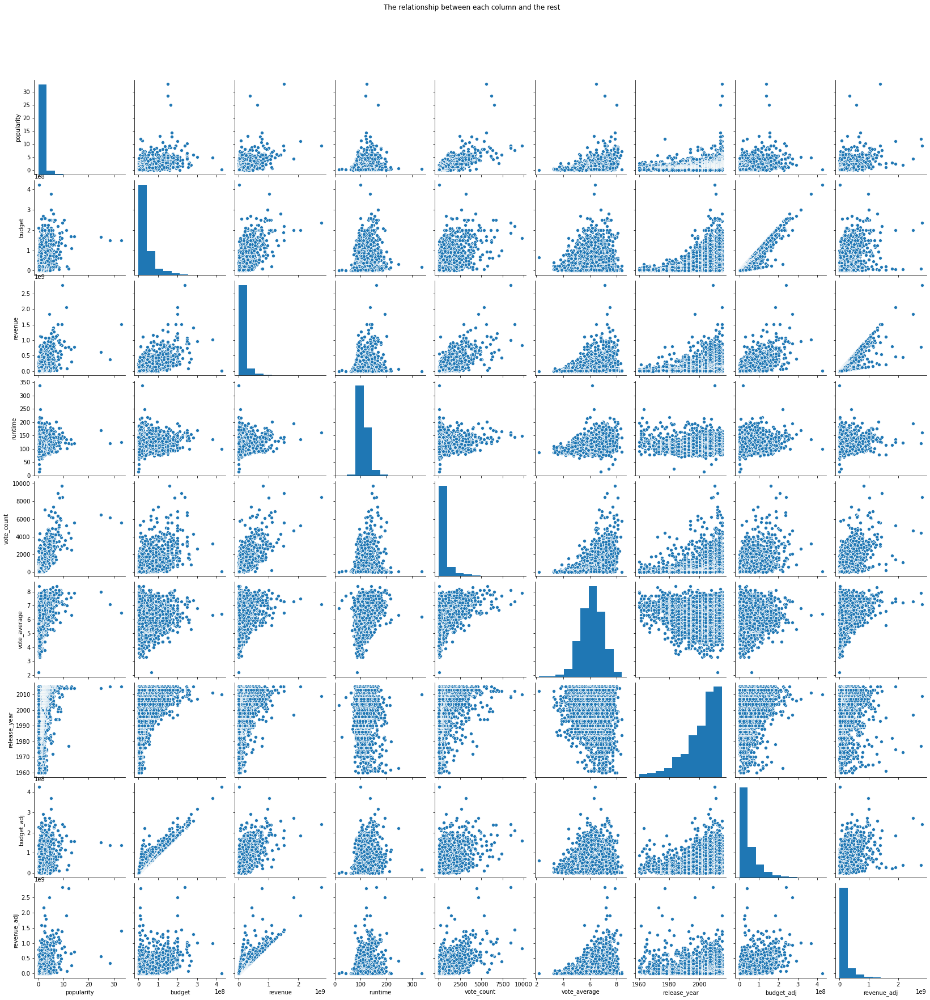

In [17]:
#!pip install seaborn
#import seaborn as sns
g = sns.pairplot(df)
g.fig.suptitle("The relationship between each column and the rest", y=1.08) # y= some height>1

### make new column called release_month

In [18]:
#make new column called release_month
df['release_month'] = pd.DatetimeIndex(df['release_date']).month
df.head()

,popularity,budget,revenue,original_title,cast,director,runtime,genres,production_companies,release_date,vote_count,vote_average,release_year,budget_adj,revenue_adj,release_month
0,32.985763,150000000,1513528810,Jurassic World,Chris Pratt|Bryce Dallas Howard|Irrfan Khan|Vi...,Colin Trevorrow,124,Action|Adventure|Science Fiction|Thriller,Universal Studios|Amblin Entertainment|Legenda...,6/9/15,5562,6.5,2015,1.379999e+08,1.392446e+09,6
1,28.419936,150000000,378436354,Mad Max: Fury Road,Tom Hardy|Charlize Theron|Hugh Keays-Byrne|Nic...,George Miller,120,Action|Adventure|Science Fiction|Thriller,Village Roadshow Pictures|Kennedy Miller Produ...,5/13/15,6185,7.1,2015,1.379999e+08,3.481613e+08,5
2,13.112507,110000000,295238201,Insurgent,Shailene Woodley|Theo James|Kate Winslet|Ansel...,Robert Schwentke,119,Adventure|Science Fiction|Thriller,Summit Entertainment|Mandeville Films|Red Wago...,3/18/15,2480,6.3,2015,1.012000e+08,2.716190e+08,3
3,11.173104,200000000,2068178225,Star Wars: The Force Awakens,Harrison Ford|Mark Hamill|Carrie Fisher|Adam D...,J.J. Abrams,136,Action|Adventure|Science Fiction|Fantasy,Lucasfilm|Truenorth Productions|Bad Robot,12/15/15,5292,7.5,2015,1.839999e+08,1.902723e+09,12
4,9.335014,190000000,1506249360,Furious 7,Vin Diesel|Paul Walker|Jason Statham|Michelle ...,James Wan,137,Action|Crime|Thriller,Universal Pictures|Original Film|Media Rights ...,4/1/15,2947,7.3,2015,1.747999e+08,1.385749e+09,4


### the films that has the highest vote average 

In [19]:
#the films that has the highest vote average
df[df.vote_average == df.vote_average.max()]

,popularity,budget,revenue,original_title,cast,director,runtime,genres,production_companies,release_date,vote_count,vote_average,release_year,budget_adj,revenue_adj,release_month
1428,7.192039,25000000,28341469,The Shawshank Redemption,Tim Robbins|Morgan Freeman|Bob Gunton|William ...,Frank Darabont,142,Drama|Crime,Castle Rock Entertainment,9/10/94,5754,8.4,1994,3.677779e+07,4.169346e+07,9
2806,0.283191,1200000,4978922,Stop Making Sense,David Byrne|Tina Weymouth|Chris Frantz|Jerry H...,Jonathan Demme,88,Documentary|Music,Talking Heads|Arnold Stiefel Company,11/16/84,23,8.4,1984,2.518850e+06,1.045097e+07,11


### which year and month that has the largest revenue ?

In [20]:
#which year and month that has the largest revenue 
dff = df.groupby(['release_year', 'release_month'])['budget', 'revenue'].sum()
dff.loc[dff['revenue'].idxmax()] 
#dff.loc[dff['revenue'].idxmin()]

<ipython-input-20-67f39365c189>:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  dff = df.groupby(['release_year', 'release_month'])['budget', 'revenue'].sum()


budget      719800000
revenue    4500111238
Name: (2015, 6), dtype: int64

### which film have the largest revenue and how much it?

In [21]:
#which film have the largest revenue and how much it
dff = df.groupby('original_title')['budget', 'revenue'].sum()
dff.loc[dff['revenue'].idxmax()]

<ipython-input-21-0aebe5ce2697>:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  dff = df.groupby('original_title')['budget', 'revenue'].sum()


budget      237000000
revenue    2781505847
Name: Avatar, dtype: int64

### This is a histogram that shown the distribution of the budget and the shape of data

Text(0.5, 1.0, 'The distrubtion budget ')

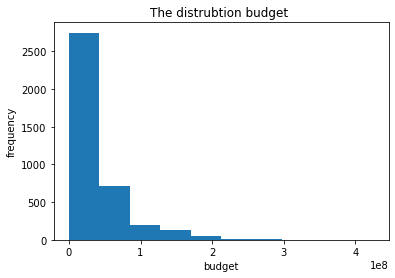

In [22]:
#This is a histogram that shown the distribution of the budget and the shape of data
plt.hist(df['budget'])
plt.xlabel("budget")
plt.ylabel("frequency")
plt.title("The distrubtion budget ")


### This is a histogram that shown the distribution of the revenue


Text(0.5, 1.0, 'The distrubtion revenue ')

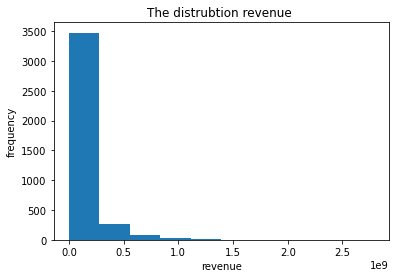

In [23]:
#This is a histogram that shown the distribution of the revenue
plt.hist(df['revenue'])
plt.xlabel("revenue")
plt.ylabel("frequency")
plt.title("The distrubtion revenue ")


###  This plot shows us the relation between budget and revenue

Text(0.5, 1.0, 'the relation between budget and revenue')

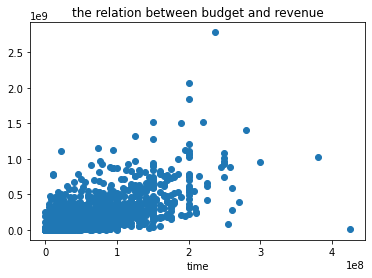

In [24]:
#This plot shows us the relation between budget and revenue
plt.scatter (df['budget'], df['revenue'])
plt.xlabel('time')
plt.title("the relation between budget and revenue")

Text(0.5, 1.0, 'The mean budget at the last five years')

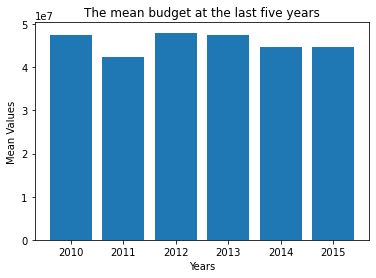

In [25]:
#We calculated the mean of budget at last five yeares using the function we defined it
#This visualization is a correlation between the means at last five years so that we can compare them easily and know 
#which year have a high budget
m_2010=get_mean(2010, 'budget')
m_2011=get_mean(2011, 'budget')
m_2012=get_mean(2012, 'budget')
m_2013=get_mean(2013, 'budget')
m_2014=get_mean(2014, 'budget')
m_2015=get_mean(2015, 'budget')

plt.bar(["2010","2011","2012","2013","2014","2015"],[m_2010,m_2011,m_2012,m_2013,m_2014,m_2015])
plt.xlabel("Years")
plt.ylabel("Mean Values")
plt.title("The mean budget at the last five years")

Text(0.5, 1.0, 'The mean revenue at the last five years')

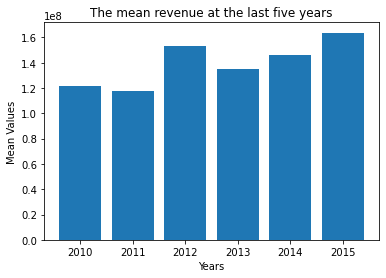

In [26]:
#We calculated the mean of revenue at last five yeares using the function we defined it
#This visualization is a correlation between the means at last five years so that we can compare them easily and know 
#which year have a high revenue
m_2010=get_mean(2010, 'revenue')
m_2011=get_mean(2011, 'revenue')
m_2012=get_mean(2012, 'revenue')
m_2013=get_mean(2013, 'revenue')
m_2014=get_mean(2014, 'revenue')
m_2015=get_mean(2015, 'revenue')

plt.bar(["2010","2011","2012","2013","2014","2015"],[m_2010,m_2011,m_2012,m_2013,m_2014,m_2015])
plt.xlabel("Years")
plt.ylabel("Mean Values")
plt.title("The mean revenue at the last five years")

<a id='conclusions'></a>
## Conclusions



> This is a dataset talked about films and all information about the film and I had know from this dataset 
> 2013 is the year have the largest budget and 2015 is the year have the largest revenue , 
> Walt Disney Pictures and Pixar Animation Studios are the production companies have the largest revenue , 
> Steven Spielberg the most director make movie , 
> Avatar is the most movie have the largest revenue ,

limitations:-
> When I begin to clean data I found that there is many zeros at revenue and budget and removed it ,
> and I found that there is some production companies and I replaced it by empty string.
>>Is there is something better than doing this?

